In [1]:
# !pip install librosa
# !pip install ipywidgets
!pip install -U efficientnet > /dev/null
!pip install resnest > /dev/null
!pip install fvcore > /dev/null
!pip install visualkeras > /dev/null

You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


EDA using librosa and Audio to see and hear the audio dataset.

In [2]:
# Necessary imports
%matplotlib notebook

import os
import sys
import librosa  # python package for music and audio analysis
import librosa.display
import IPython.display as ipd
# playing audio
from IPython.display import Audio
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import ipywidgets as widgets
import seaborn as sns
from sklearn import preprocessing
import visualkeras

from tensorflow import keras
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, GlobalAveragePooling2D, InputLayer
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.applications.imagenet_utils import preprocess_input
#from tensorflow.python.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
import efficientnet.tfkeras as efn #Convolutional Neural Network architecture
from efficientnet.keras import center_crop_and_resize, preprocess_input
from sklearn.utils import class_weight

import torch.nn as nn
##from resnest.torch import resnest50
import fvcore
import torch

# plotting style
sns.set_style("whitegrid")
sns.set_palette("muted")

# format plot options
plt.rcParams["xtick.labelsize"] = 14
plt.rcParams["ytick.labelsize"] = 14
plt.rcParams["patch.force_edgecolor"] = True

In [3]:
# define various paths

# directories of train and test sets' audio files
root_dir = '../input/rfcx-species-audio-detection'
train_audio = os.path.join(root_dir, 'train')
test_audio = os.path.join(root_dir, 'test')

# True positives and false positives metadata
train_tp = os.path.join(root_dir, 'train_tp.csv')
train_fp = os.path.join(root_dir, 'train_fp.csv')

In [4]:
# training dataset showing true positives
tp_df = pd.read_csv(train_tp)
tp_df.head()

,recording_id,species_id,songtype_id,t_min,f_min,t_max,f_max
0,003bec244,14,1,44.5440,2531.250,45.1307,5531.25
1,006ab765f,23,1,39.9615,7235.160,46.0452,11283.40
2,007f87ba2,12,1,39.1360,562.500,42.2720,3281.25
3,0099c367b,17,4,51.4206,1464.260,55.1996,4565.04
4,009b760e6,10,1,50.0854,947.461,52.5293,10852.70


In [5]:
tp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1216 entries, 0 to 1215
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   recording_id  1216 non-null   object 
 1   species_id    1216 non-null   int64  
 2   songtype_id   1216 non-null   int64  
 3   t_min         1216 non-null   float64
 4   f_min         1216 non-null   float64
 5   t_max         1216 non-null   float64
 6   f_max         1216 non-null   float64
dtypes: float64(4), int64(2), object(1)
memory usage: 66.6+ KB


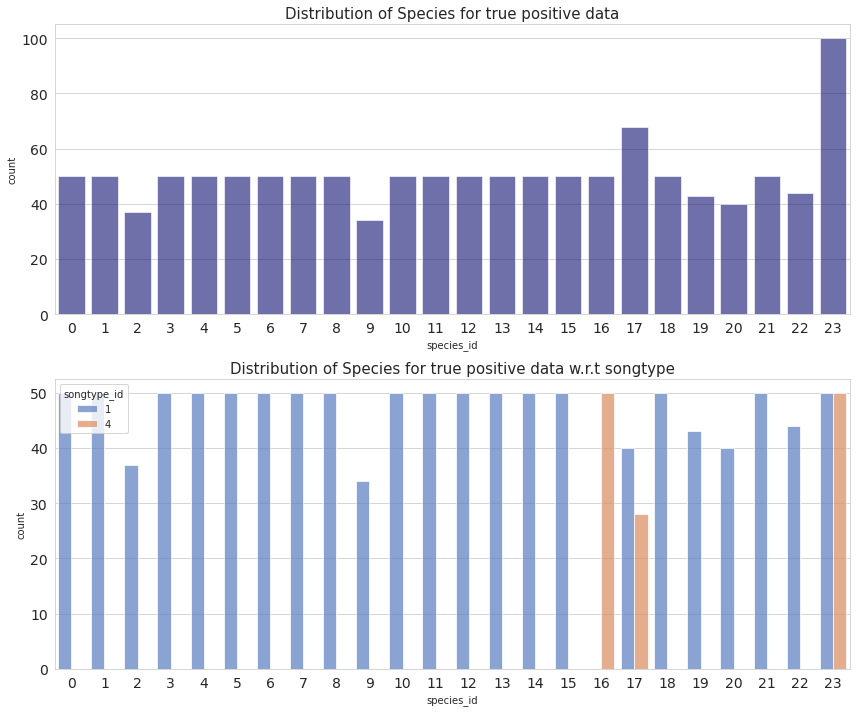

In [6]:
%matplotlib inline
# explore the target column, i.e. species_id
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 10))
sns.countplot(ax=ax[0], x='species_id', data=tp_df, alpha=0.6, color='navy')
ax[0].set_title('Distribution of Species for true positive data', fontsize=15)

sns.countplot(ax=ax[1], x='species_id', hue='songtype_id', data=tp_df, alpha=0.7)
ax[1].set_title('Distribution of Species for true positive data w.r.t songtype', fontsize=15)
fig.tight_layout()
plt.show()

As evident from the above plots, species are almost uniformly distributed in the true positive dataset. Also, other than species with `species_id` 16, 17, and 23, all the species have just one `songtype`, or type of sound produced by a given species.

ID Scientific Name

0 Eleutherodactylus gryllus

1 Eleutherodactylus brittoni

2 leptodactylus albilabris

3 Eleutherodactylus coqui

4 Eleutherodactylus hedricki

5 Dendroica angelae

6 Melanerpes portoricensis

7 Coereba flaveola

8 Eleutherodactylus locustus

9 Margarops fuscatus

10 Loxigilla portoricensis

11 Vireo altiloquus

12 Eleutherodactylus portoricensis

13 Megascops nudipes

14 Eleutherodactylus richmondi

15 Patagioenas squamosa

16 Eleutherodactylus antillensis

17 Turdus plumbeus

18 Eleutherodactylus unicolor

19 Coccyzus vieilloti

20 Todus mexicanus

21 Eleutherodactylus wightmanae

22 Nesospingus speculiferus

23 Spindalis portoricensis

In [7]:
# select some random samples of species 1 from train set
def get_random_samples(data_path, species_id=3, num_samples=3):
    
    data_list = list(tp_df[tp_df['species_id'] == species_id]['recording_id'])
    indices = np.random.choice(len(data_list), num_samples)
    
    sample_audio = [os.path.join(data_path, str(data_list[idx])+'.flac') for idx in indices]
    starts = [tp_df[tp_df['recording_id'] == data_list[idx]].iloc[0, 3] for idx in indices]
    stops = [tp_df[tp_df['recording_id'] == data_list[idx]].iloc[0, 5] for idx in indices]
    
    return sample_audio, starts, stops

In [8]:
# get 3 random train samples of species 3, Eleutherodactylus coqui
audio_samples_train, start_times, stop_times = get_random_samples(train_audio, species_id=3, num_samples=3)

In [9]:
print(f"Eleutherodactylus coqui call starts at {start_times[0]} and ends at {stop_times[0]}.")

Audio(audio_samples_train[0])

Eleutherodactylus coqui call starts at 28.5547 and ends at 29.296.


In [10]:
print(f"Eleutherodactylus coqui call starts at {start_times[1]} and ends at {stop_times[1]}.")
Audio(audio_samples_train[1])

Eleutherodactylus coqui call starts at 12.752 and ends at 13.4933.


In [11]:
print(f"Eleutherodactylus coqui call starts at {start_times[2]} and ends at {stop_times[2]}.")
Audio(audio_samples_train[2])

Eleutherodactylus coqui call starts at 20.0747 and ends at 20.816.


In [12]:
# get 3 random train samples of species 5, Dendroica angelae
audio_samples, start_times, stop_times = get_random_samples(train_audio, species_id=3, num_samples=3)

In [13]:
print(f"Dendroica angelae call starts at {start_times[0]} and ends at {stop_times[0]}.")
Audio(audio_samples[0])

Dendroica angelae call starts at 53.61600000000001 and ends at 54.3573.


In [14]:
print(f"Dendroica angelae call starts at {start_times[1]} and ends at {stop_times[1]}.")
Audio(audio_samples[1])

Dendroica angelae call starts at 20.976 and ends at 21.7173.


In [15]:
print(f"Dendroica angelae call starts at {start_times[2]} and ends at {stop_times[2]}.")
Audio(audio_samples[2])

Dendroica angelae call starts at 59.2533 and ends at 59.9947.


Recording ID: 2eb098e76
Total number of samples in the recording: 1323000
Sampling rate of the recording: 22050
Checking the data corresponding to the recording ID
    recording_id  species_id  songtype_id    t_min    f_min    t_max   f_max
231    2eb098e76           3            1  28.5547  1031.25  29.2960  2812.5
232    2eb098e76           2            1  20.8693   468.75  22.6453  3000.0
233    2eb098e76           2            1  24.9653   468.75  26.7413  3000.0
Now plotting the recording waveform...


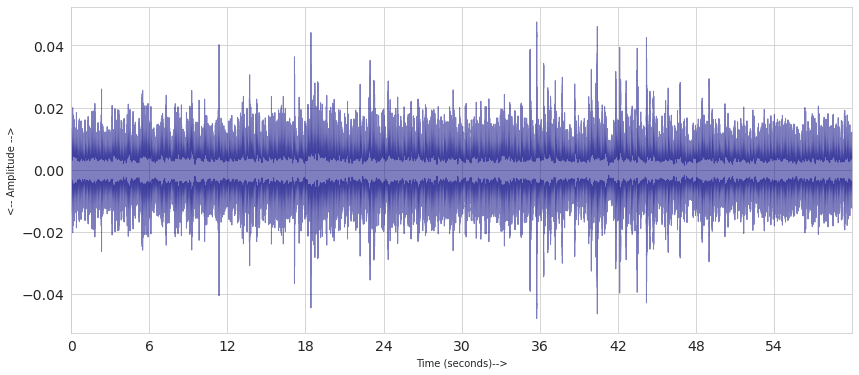

In [16]:
from librosa import display
%matplotlib inline

train_amp, train_sr = librosa.load(audio_samples_train[0])
record_id = os.path.basename(audio_samples_train[0]).split('.')[0]

print(f'Recording ID: {record_id}')
print(f'Total number of samples in the recording: {len(train_amp)}')
print(f'Sampling rate of the recording: {train_sr}')

print('Checking the data corresponding to the recording ID')
record_df = tp_df[tp_df["recording_id"] == record_id]

if record_df.empty:
    record_df = fp_df[fp_df["recording_id"] == record_id]
print(record_df)

print('Now plotting the recording waveform...')
plt.figure(figsize=(14, 6))
librosa.display.waveplot(y=train_amp, sr=train_sr, color='navy', alpha=0.5)
plt.xlabel('Time (seconds)-->')
plt.ylabel('<-- Amplitude -->')
plt.show()

`train_amp` is just an array of amplitudes whose length gives total number of samples whereas `train_sr` is the sampling rate.

__Sampling rate__ or __Sampling frequency__ is the rate at which we are capturing amplitudes. In other words, it is just the number of data points recorded per second. These amplitudes can be electric or magnetic fileds in the case of light waves, current or voltage in the case of digital signals and pressure or displacement values for the case of sound waves.

The above plot gives the time-domain representation of the signal. Higher amplitude just corresponds to loudness in the signal and the points of zero amplitude represent silence. Other than giving information about the variation of the loudness of the audio signal with time, time-domain does not convey other important information about the signal.

We can rather try to understand the signal in frequency domain which reveals much more information about the signal. The reason for that is the sound that we are hearing results from the superposition of many different audio signals with different frequencies. 

This is our motivation for working in the frequency domain since we can decompose the wave into its constituent frequencies. The mathematical tools used for this is called __Fourier Transform__. Since our signal is composed of several discrete samples, we will use Fast Fourier Transform instead of usual Fourier Transform.

Librosa has a special method which performs Fourier transform, it's called `stft` (Short Time Fourier Transform). Using `stft` we can generate a plot which shows the signal in frequency-time space, this plot is commonly referred to as __Spectrogram__.

## Spectrograms

Using Librosa, we can easily create spectrograms using Short Time Fourier Transform. Following two plots show spectrograms for train audio on both Hertz (linear) as well as log scale.

(1025, 2584)
(1025, 2584)


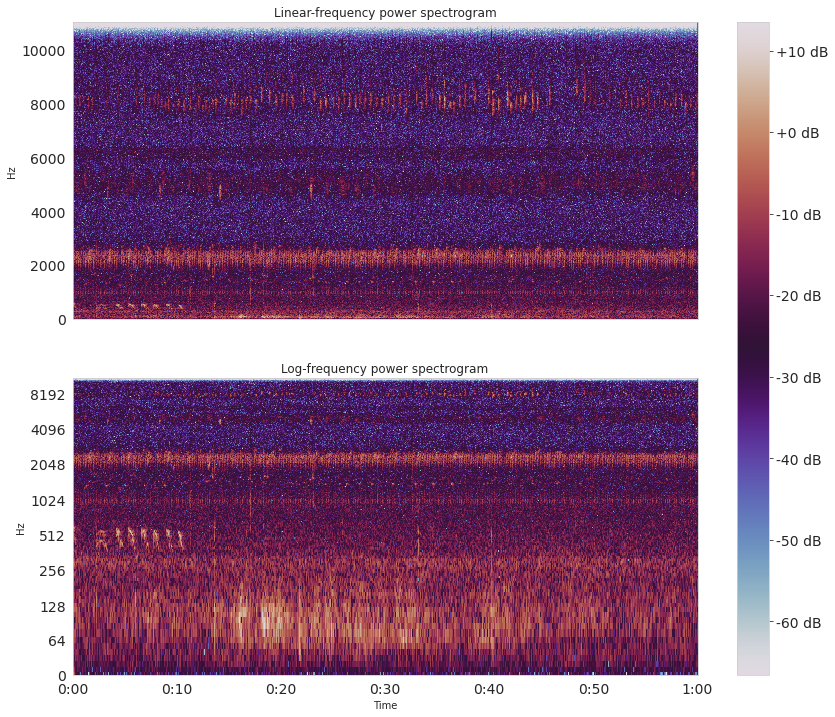

In [17]:
# perform stft on amplitude of sound wave
train_spec = librosa.stft(train_amp)
print(train_spec.shape)

# convert stft amplitude into decibel scale
train_db = librosa.amplitude_to_db(abs(train_spec))
print(train_db.shape)

fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(14, 12), sharex=True)
img = librosa.display.specshow(train_db, sr=train_sr, x_axis='time', 
                         y_axis='hz', ax=ax[0], cmap='twilight')
ax[0].set(title='Linear-frequency power spectrogram')
ax[0].label_outer()

librosa.display.specshow(train_db, sr=train_sr, x_axis='time', 
                         y_axis='log', ax=ax[1], cmap='twilight')
ax[1].set(title='Log-frequency power spectrogram')
ax[1].label_outer()
fig.colorbar(img, ax=ax, format='%+2.f dB')
plt.show()

Clearly, frequencies in`log` scale show much more detail than the linear scale. However, in the linear scale, the perceptual distance between 300 Hz and 500 Hz might not seem equal to the distance between 11400 Hz and 11600Hz to human ears even though the difference is the same. So it is quite common so describe the spectrogram in __mel__ scale which is similar to the `log` scale and it is defined as 
$$
f_{m} = 2595\: \mathrm{log}_{10}\left( 1 + \frac{f}{700}\right)
$$
Mel scale is just a result of the above non-linear transformation. It renders the frequencies, that are at equal distances from each other, also felt by humans as if they are at equal distances. This is because human ear does not perceive frequencies on a linear scale.

## Mel-Spectrograms

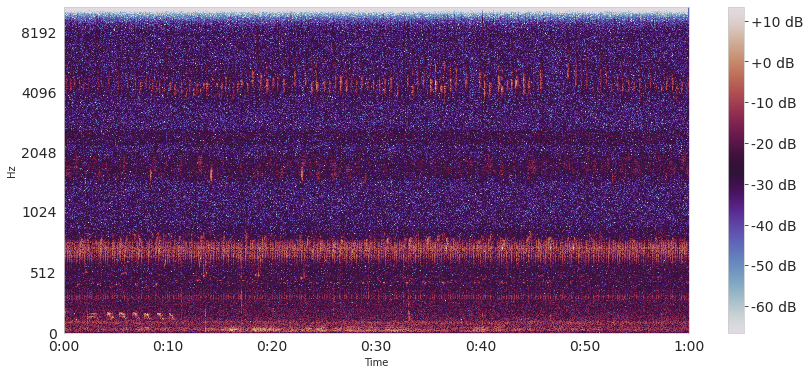

In [18]:
plt.figure(figsize=(14, 6))
librosa.display.specshow(train_db, sr=train_sr, x_axis='time', 
                         y_axis='mel', cmap='twilight')
plt.colorbar(format='%+2.0f dB')
plt.show()

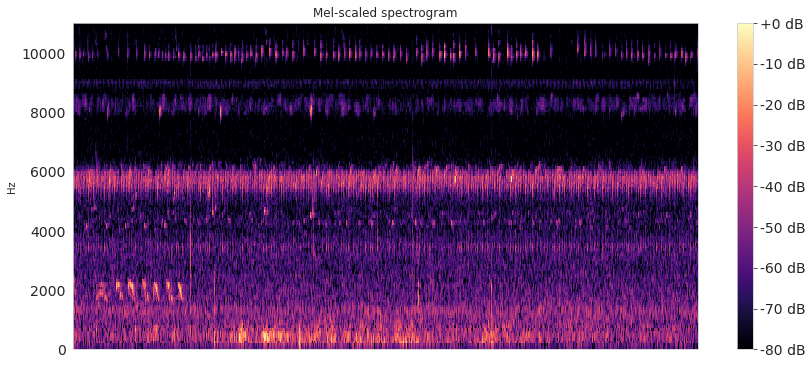

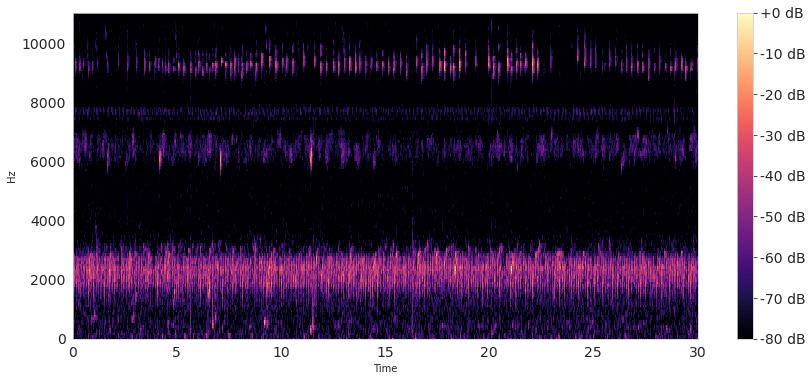

In [19]:
# Plot mel-spectrogram
N_FFT = 1024         
HOP_SIZE = 1024       
N_MELS = 128            
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
FMIN = 0 

S = librosa.feature.melspectrogram(y = train_amp, sr = train_sr,
                                   n_fft = N_FFT,
                                   hop_length = HOP_SIZE,
                                   n_mels = N_MELS,
                                   htk = True,
                                   fmin = FMIN,
                                   fmax = train_sr/2) 

plt.figure(figsize=(14, 6))
librosa.display.specshow(librosa.power_to_db(S**2, ref=np.max), fmin=FMIN, y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-scaled spectrogram')
plt.show()

# Plot mel-spectrogram with high-pass filter (FMIN=1400 removes useless noise since birds sing in high frequencies)
N_FFT = 1024         
HOP_SIZE = 1024       
N_MELS = 128            
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
FMIN = 1400 

S = librosa.feature.melspectrogram(y = train_amp, sr = train_sr,
                                    n_fft=N_FFT,
                                    hop_length=HOP_SIZE, 
                                    n_mels=N_MELS, 
                                    htk=True,
                                    fmin=FMIN, 
                                    fmax=train_sr/2) 

plt.figure(figsize=(14, 6))
librosa.display.specshow(librosa.power_to_db(S**2, ref=np.max), fmin=FMIN,  x_axis='time', y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.show()

In [20]:
import torch.utils.data as torchdata
from PIL import Image

bmp_dir = '../input/train-bmp/rain_results/'
num_birds = 24

class RainforestDataset(torchdata.Dataset):
    def __init__(self, filelist):
        self.specs = []
        self.labels = []
        for f in filelist:
            # Easier to pass species in filename at the start; worth changing later to more capable method
            label = int(str.split(f, '_')[1])
            label_array = np.zeros(num_birds, dtype=np.single)
            label_array[label] = 1.
            self.labels.append(label_array)
            
            # Open and save spectrogram to memory
            
            # If you use more spectrograms (add train_fp, for example), then they would not all fit to memory
            # In this case you should load them on the fly in __getitem__
            img = Image.open(bmp_dir + f)
            mel_spec = np.array(img)
            img.close()
            
            # Transforming spectrogram from bmp to 0..1 array
            mel_spec = mel_spec / 255
            # Stacking for 3-channel image for resnet
            mel_spec = np.stack((mel_spec, mel_spec, mel_spec))
            
            self.specs.append(mel_spec)
    
    def __len__(self):
        return len(self.specs)
    
    def __getitem__(self, item):
        # Augment here if you want
        return self.specs[item], self.labels[item]

In [32]:
file_list = []
label_list = []

for f in os.listdir(bmp_dir):
    if '.bmp' in f:
        file_list.append(f)
        label = str.split(f, '_')[1]
        label_list.append(label)


from sklearn.model_selection import StratifiedKFold

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

train_files = []
val_files = []

for fold_id, (train_index, val_index) in enumerate(skf.split(file_list, label_list)):
    # Picking only first fold to train/val on
    # This means loss of 20% training data
    # To avoid this, you can train 5 different models on 5 folds and average predictions
    if fold_id == 0:
        train_files = np.take(file_list, train_index)
        val_files = np.take(file_list, val_index)

print('Training on ' + str(len(train_files)) + ' examples')
print('Validating on ' + str(len(val_files)) + ' examples')

Training on 972 examples
Validating on 244 examples


In [22]:
print(train_files[0:4])
print(val_files[0:4])

['bbd784551_13_2194046.0.bmp' 'f9e724b46_22_809856.0.bmp'
 '8f8e4f3e2_22_620160.0.bmp' '2eb098e76_2_1240958.0.bmp']
['d6c75de73_2_2054270.0.bmp' 'd9a1b1ea9_1_1873920.0.bmp'
 '596463649_9_199937.0.bmp' 'e7847849b_4_45826.0.bmp']


In [33]:
# filter tp_df into train and val files based on train_files and val_files

def get_file_df(filelist):
    
    rec_id_list = []
    
    for f in filelist:
        rec_id = str.split(f, '_')[0]
        spec_id = str.split(f, '_')[1]
        rec_id_list.append([rec_id, f, spec_id])
        
    return pd.DataFrame(rec_id_list, columns = ['recording_id', 'file_name', 'species_id'])

In [34]:
train_df = get_file_df(train_files)
val_df = get_file_df(val_files)
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 972 entries, 0 to 971
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   recording_id  972 non-null    object
 1   file_name     972 non-null    object
 2   species_id    972 non-null    object
dtypes: object(3)
memory usage: 22.9+ KB


In [35]:
IM_SIZE = (224, 400) 
BIRDS = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
         '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23']
DATA_PATH = bmp_dir
BATCH_SIZE = 16

# could also have ImageDataGenerator do the validation split like this:
# train_datagen = ImageDataGenerator(rescale=1./255.,validation_split=0.25)

# train/val split was already done above, so using those file lists/dfs
train_datagen = ImageDataGenerator(preprocessing_function = preprocess_input,  
                                   width_shift_range = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.1,
                                   fill_mode = 'nearest')

train_batches = train_datagen.flow_from_dataframe(dataframe = train_df,
                                                  directory = DATA_PATH,
                                                  x_col = 'file_name',
                                                  y_col = 'species_id',
                                                  #subset = 'training',
                                                  target_size = IM_SIZE,
                                                  color_mode = 'rgb',
                                                  class_mode = 'categorical', 
                                                  batch_size = BATCH_SIZE,
                                                  #seed = 42,
                                                  shuffle = False)

val_datagen = ImageDataGenerator(preprocessing_function = preprocess_input,
                                 width_shift_range = 0.2,
                                 height_shift_range = 0.2,
                                 shear_range = 0.2,
                                 zoom_range = 0.1,
                                 fill_mode = 'nearest')

val_batches = val_datagen.flow_from_dataframe(dataframe = val_df,
                                              directory = DATA_PATH,
                                              x_col = 'file_name',
                                              y_col = 'species_id',
                                              #subset = 'validation',
                                              target_size = IM_SIZE,
                                              color_mode = 'rgb',
                                              class_mode = 'categorical',
                                              batch_size = BATCH_SIZE,
                                              #seed = 42,
                                              shuffle = False)

# test_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)

# test_batches = test_datagen.flow_from_directory(root_dir + '/test',
#                                                 classes = None,
#                                                 target_size = IM_SIZE,
#                                                 color_mode = 'rgb',
#                                                 class_mode = None, 
#                                                 #batch_size=BATCH_SIZE,
#                                                 shuffle=False)

Found 972 validated image filenames belonging to 24 classes.
Found 244 validated image filenames belonging to 24 classes.


In [36]:
#Define CNN's architecture
net = efn.EfficientNetB3(include_top = False,
                        weights = 'imagenet',
                        input_tensor = None,
                        input_shape = (224, 400, 3))  
x = net.output
x = Conv2D(filters=10, kernel_size=3, activation='relu', padding='same')(x)
# x = Conv2D(filters=20, kernel_size=3, activation='relu', padding='same')(x)
# x = Conv2D(filters=30, kernel_size=3, activation='relu', padding='same')(x)
x = GlobalAveragePooling2D()(x)
x = Flatten()(x)
x = Dropout(0.3)(x)
output_layer = Dense(len(BIRDS), activation='sigmoid', name='sigmoid')(x)
net_final = Model(inputs=net.input, outputs=output_layer)     
net_final.compile(optimizer=Adam(),
                  loss='binary_crossentropy', 
                  metrics=['accuracy'])

In [30]:
# Estimate class weights for unbalanced dataset
class_weights = class_weight.compute_class_weight(
               'balanced',
                np.unique(train_batches.classes), 
                train_batches.classes)

# Define callbacks
ModelCheck = ModelCheckpoint('efficientnet_checkpoint.h5', monitor='val_loss', verbose=0, 
                             save_best_only=True, save_weights_only=True, mode='auto')

ReduceLR = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=5)

In [37]:
# Train the model
history = net_final.fit(train_batches,
                        validation_data = val_batches,
                        epochs = 100,
                        verbose = 2,
                        callbacks=[EarlyStopping(patience=8, verbose=1, restore_best_weights=True),
                                   ReduceLROnPlateau(factor=.2, patience=5, verbose=1),
                                   ModelCheckpoint('/kaggle/working/efficientnet_checkpoint.hdf5', save_best_only=True)
                                  ])

Epoch 1/100
61/61 - 40s - loss: 0.4914 - accuracy: 0.0463 - val_loss: 0.3155 - val_accuracy: 0.0410
Epoch 2/100
61/61 - 38s - loss: 0.3094 - accuracy: 0.0473 - val_loss: 0.2041 - val_accuracy: 0.0287
Epoch 3/100
61/61 - 38s - loss: 0.2426 - accuracy: 0.0514 - val_loss: 0.1791 - val_accuracy: 0.0820
Epoch 4/100
61/61 - 36s - loss: 0.2096 - accuracy: 0.0874 - val_loss: 0.1854 - val_accuracy: 0.0861
Epoch 5/100
61/61 - 38s - loss: 0.1977 - accuracy: 0.1173 - val_loss: 0.1685 - val_accuracy: 0.1311
Epoch 6/100
61/61 - 38s - loss: 0.1871 - accuracy: 0.1481 - val_loss: 0.1604 - val_accuracy: 0.1762
Epoch 7/100
61/61 - 37s - loss: 0.1772 - accuracy: 0.1842 - val_loss: 0.1597 - val_accuracy: 0.2664
Epoch 8/100
61/61 - 37s - loss: 0.1707 - accuracy: 0.2191 - val_loss: 0.1377 - val_accuracy: 0.4057
Epoch 9/100
61/61 - 35s - loss: 0.1602 - accuracy: 0.2685 - val_loss: 0.1708 - val_accuracy: 0.3238
Epoch 10/100
61/61 - 36s - loss: 0.1495 - accuracy: 0.3416 - val_loss: 0.1535 - val_accuracy: 0.2992

In [38]:
val_predict = net_final.predict(val_batches)
print(val_predict.shape)
val_predict[1]

(244, 24)


array([6.6652428e-05, 9.4053257e-01, 1.3595430e-10, 1.3571582e-08,
       2.0944554e-02, 4.6259989e-05, 7.0460606e-04, 1.0933023e-05,
       9.2135712e-09, 7.9318024e-06, 1.0091143e-03, 1.3288379e-09,
       6.9233669e-15, 8.1137994e-05, 9.0294208e-09, 4.4052058e-07,
       1.8744357e-04, 3.4741865e-04, 4.5659468e-07, 7.1424576e-03,
       3.8486225e-05, 4.8880738e-10, 4.1650396e-06, 4.5832825e-05],
      dtype=float32)

In [39]:
score = net_final.evaluate(val_batches, verbose=0)
print(f'Test loss: {score[0]} / Test accuracy: {score[1]}')

Test loss: 0.08849281072616577 / Test accuracy: 0.7008196711540222


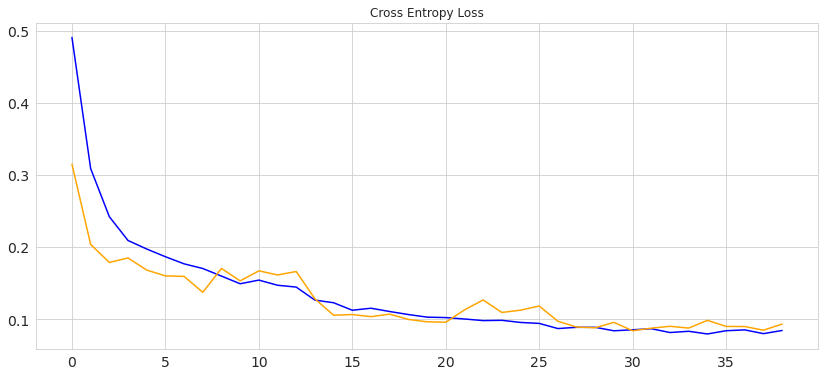

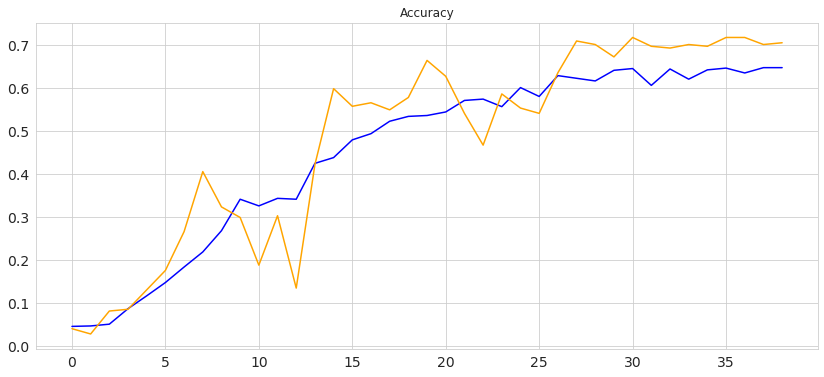

In [40]:
%matplotlib inline
# plot diagnostic learning curves
def summarize_diagnostics(history):
    # plot loss
    plt.figure(figsize=(14, 6))
    plt.title('Cross Entropy Loss')
    plt.plot(history.history['loss'], color='blue', label='train')
    plt.plot(history.history['val_loss'], color='orange', label='test')
    plt.show()
    # plot accuracy
    plt.figure(figsize=(14, 6))
    plt.title('Accuracy')
    plt.plot(history.history['accuracy'], color='blue', label='train')
    plt.plot(history.history['val_accuracy'], color='orange', label='test')
    # save plot to file
    #filename = sys.argv[0].split('/')[-1]
    #pyplot.savefig(filename + '_plot.png')
    plt.show()
    
# learning curves
summarize_diagnostics(history)

In [41]:
Y_pred = net_final.predict(val_batches)
y_pred = np.argmax(Y_pred, axis=1)

In [42]:
np.max(Y_pred, axis=0)

array([0.49553916, 0.96899766, 0.97797024, 0.9858612 , 0.88522875,
       0.7170167 , 0.71696264, 0.9800561 , 0.9131512 , 0.709583  ,
       0.333836  , 0.9918561 , 0.994826  , 0.5062294 , 0.5081986 ,
       0.31616998, 0.9902512 , 0.14348915, 0.9406855 , 0.94923615,
       0.8217906 , 0.41121796, 0.7999275 , 0.2424558 ], dtype=float32)

In [43]:
from sklearn.metrics import confusion_matrix, classification_report, roc_curve

print(classification_report(val_batches.classes, y_pred))

              precision    recall  f1-score   support

           0       0.67      0.80      0.73        10
           1       0.82      0.90      0.86        10
           2       0.67      0.80      0.73        10
           3       0.67      0.80      0.73        10
           4       0.42      0.80      0.55        10
           5       0.62      0.50      0.56        10
           6       0.62      0.80      0.70        10
           7       0.75      0.60      0.67        10
           8       0.75      0.90      0.82        10
           9       0.57      0.93      0.70        14
          10       0.60      0.30      0.40        10
          11       1.00      0.89      0.94         9
          12       1.00      0.88      0.93         8
          13       0.83      0.62      0.71         8
          14       0.67      0.60      0.63        10
          15       0.78      0.78      0.78         9
          16       0.74      0.85      0.79        20
          17       0.00    

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [44]:
score = net_final.evaluate(train_batches, verbose=0)
print("Training Accuracy: ", score[1])

# score = model.evaluate(test_batches, verbose=0)
# print("Testing Accuracy: ", score[1])

score = net_final.evaluate(val_batches, verbose=0)
print("Validating Accuracy: ", score[1])

Training Accuracy:  0.8888888955116272
Validating Accuracy:  0.7008196711540222


In [45]:


visualkeras.layered_view(net_final).show() # display using your system viewer
visualkeras.layered_view(net_final, to_file='output.png') # write to disk
visualkeras.layered_view(net_final, to_file='output.png').show() # write and show

visualkeras.layered_view(net_final)

# Load test data and predict

### This did not work. I'm not sure how to run the model with the test files.

In [ ]:
# fft = 2048
# hop = 512
# sr = 48000
# length = 10 * sr

# test_files = os.listdir('/kaggle/input/rfcx-species-audio-detection/test/')


# def load_test_file(f):
#     wav, sr = librosa.load('/kaggle/input/rfcx-species-audio-detection/test/' + f, sr=None)

#     # Split for enough segments to not miss anything
#     segments = len(wav) / length
#     segments = int(np.ceil(segments))
    
#     mel_array = []
    
#     for i in range(0, segments):
#         # Last segment going from the end
#         if (i + 1) * length > len(wav):
#             slice = wav[len(wav) - length:len(wav)]
#         else:
#             slice = wav[i * length:(i + 1) * length]
        
#         # Same mel spectrogram as before
#         mel_spec = librosa.feature.melspectrogram(slice, n_fft=fft, hop_length=hop, sr=sr, power=1.5)
#         mel_spec = resize(mel_spec, (224, 400))
    
#         # Normalize to 0...1 - this is what goes into neural net
#         mel_spec = mel_spec - np.min(mel_spec)
#         mel_spec = mel_spec / np.max(mel_spec)
        
#         mel_spec = np.stack((mel_spec, mel_spec, mel_spec), axis=2)
#         #print(mel_spec.shape)

#         mel_array.append(mel_spec)
    
#     return mel_array

In [ ]:
# import csv
# from skimage.transform import resize

# # Prediction loop
# print('Starting prediction loop')
# with open('submission.csv', 'w', newline='') as csvfile:
#     submission_writer = csv.writer(csvfile, delimiter=',')
#     submission_writer.writerow(['recording_id','s0','s1','s2','s3','s4','s5','s6','s7','s8','s9','s10','s11',
#                                's12','s13','s14','s15','s16','s17','s18','s19','s20','s21','s22','s23'])
#     new_rows = []
#     sub_df = pd.DataFrame(columns = ['recording_id','s0','s1','s2','s3','s4','s5','s6','s7','s8','s9','s10','s11',
#                                      's12','s13','s14','s15','s16','s17','s18','s19','s20','s21','s22','s23'])
# #     print(sub_df)
    
    
#     # Every test file is split on several chunks and prediction is made for each chunk
#     for i in range(0, len(test_files)):
#         data = load_test_file(test_files[i])
# #         data = torch.tensor(data)
# #         data = data.float()
#         data = np.array(data)


#         output = net_final.predict(data)


#         # Taking max prediction from all slices per bird species
#         # Usually you want Sigmoid layer here to convert output to probabilities
#         # In this competition only relative ranking matters, and not the exact value of prediction, so we can use it directly
#         maxed_output = np.max(output, axis=0)[0]
#         #print(maxed_output)
        
#         file_id = str.split(test_files[i], '.')[0]
#         write_array = [file_id]
#         #print(write_array)
        
# #         for out in maxed_output:
#         write_array.append(output)
    
#         submission_writer.writerow(write_array)
#         new_rows.append(write_array)
        
#         if i % 100 == 0 and i > 0:
#             print('Predicted for ' + str(i) + ' of ' + str(len(test_files) + 1) + ' files')


# sub_df = sub_df.append(pd.DataFrame(new_rows, 
#                                     columns = ['recording_id','s0','s1','s2','s3','s4','s5','s6','s7','s8','s9','s10','s11',
#                                                's12','s13','s14','s15','s16','s17','s18','s19','s20','s21','s22','s23']), 
#                                     ignore_index=True)
# print('Submission generated')

In [ ]:
# sub_df.to_csv('/kaggle/working/test_results.csv',index=False)

## Here is the original simple neural network that yielded a whopping 8% accuracy.

In [ ]:
# # trying out a simple NN
# NN = Sequential()
# NN.add(InputLayer(input_shape=(224, 400, 3)))
# NN.add(Conv2D(filters=10, kernel_size=3, activation='relu', padding='same'))
# # NN.add(Conv2D(filters=20, kernel_size=3, activation='relu', padding='same'))
# # NN.add(Conv2D(filters=30, kernel_size=3, activation='relu', padding='same'))
# # Fully connected block - flattening followed by dense and output layers
# NN.add(Flatten())
# NN.add(Dense(512, activation='relu'))
# NN.add(Dropout(.20))
# NN.add(Dense(256, activation='relu'))
# NN.add(Dropout(.20))
# NN.add(Dense(num_birds, activation='sigmoid'))  # 24 target classes

# NN.compile(
#     loss='binary_crossentropy',
#     optimizer='adam',
#     metrics=['accuracy'],
# )
# NN.summary()


In [ ]:
# NN.fit(train_batches,
#        validation_data = val_batches,
#        epochs = 30)
#        #steps_per_epoch= 1596)
# #                  class_weight=class_weights, 
# #                  callbacks=[ModelCheck,ReduceLR])

In [ ]:
# # can't do this with the actual test audio because the competition doesn't supply the labels.
# # would have to submit to get the score
# from sklearn.metrics import accuracy_score
# accuracy_score(y_test, np.argmax(NN.predict(X_test), axis=-1))

### References:
1. Librosa [documentation](https://librosa.org/doc/main/feature.html)
2. https://musicinformationretrieval.com/index.html
3. https://www.kaggle.com/fffrrt/all-in-one-rfcx-baseline-for-beginners/notebook
4. https://www.kdnuggets.com/2020/02/audio-data-analysis-deep-learning-python-part-1.html